In [1]:
from PIL import Image
import cv2
import numpy as np
import time

## Алгоритм VNG

#### Класс, решающий данную задачу

In [2]:
class ColorRecovery:
    def __init__(self, img_name):
        self.input_img = cv2.imread(img_name, cv2.IMREAD_GRAYSCALE)
        self.algorithms = ['VNG']
        
        
        
    def get_colored_image(self, output_image_name, algorithm='VNG'):
        if algorithm not in self.algorithms:
            print('/"%s/" algorithm is not supported.' % algorithm)
            
        if algorithm == 'VNG':
            h = self.input_img.shape[0]
            w = self.input_img.shape[1]
            self.out_img = np.zeros((h, w, 3), np.uint8)
            
            working_time = self.vng_recovery()
            cv2.imwrite(output_image_name, self.out_img)
            
            return working_time, 1000000 * working_time / (h * w)
            
    
    
    # проверка, что значение цвета входит в отрезок [0, 250]
    def get_uint8(self, x):
        if x <= 0:
            return np.uint8(0)
        elif x >= np.uint8(255):
            return np.uint8(255)
        else:
            return np.uint8(x)
    
    
    
    # проход по всем пикселям
    def vng_recovery(self):
        start_time = time.time()
        for x in range(2, len(self.input_img) - 2):
            for y in range(2, len(self.input_img[x]) - 2):
                # определим цвет пикселя (2 случая для зеленого и по 1 для карсного и синего)
                if (x + y) % 2 != 0:
                    if x % 2 == 0:
                        color = "GB"
                    else:
                        color = "GR"
                else:
                    if x % 2 == 0:
                        color = "B"
                    else:
                        color = "R"
                        
                # найдем все пиксели в матрице 5x5
                inp_arr = np.array([self.input_img[x-2][y-2:y+3],
                          self.input_img[x-1][y-2:y+3],
                          self.input_img[x][y-2:y+3],
                          self.input_img[x+1][y-2:y+3],
                          self.input_img[x+2][y-2:y+3]]).astype(int)
                
                # определим градиенты
                grads = self.calc_grads(inp_arr, color)
                
                # и найдем остальные значения для данного пикселя
                add = self.calc_additional_channel(color, grads, inp_arr)
                self.out_img[x][y][0] = self.get_uint8(add[0])
                self.out_img[x][y][1] = self.get_uint8(add[1])
                self.out_img[x][y][2] = self.get_uint8(add[2])
                
        # фиксируем время работы алгоритма
        working_time = time.time() - start_time
        return working_time

#### Подсчет градиентов и отсечение ненужных

In [3]:
def calc_grads(self, arr, color):
    # для упрощения подсчета (и читаемости кода) будем использовать пункты 3.2 и 3.3 из статьи
    
    # 3.2
    if color == "GB" or color == "GR":
        # green:
        g1=arr[0][0]
        g2=arr[0][2]
        g3=arr[0][4]
        g4=arr[1][1]
        g5=arr[1][3]
        g6=arr[2][0]
        g7=arr[2][2]
        g8=arr[2][4]
        g9=arr[3][1]
        g10=arr[3][3]
        g11=arr[4][0]
        g12=arr[4][2]
        g13=arr[4][4]
        
        # red
        r1=arr[1][0]
        r2=arr[1][2]
        r3=arr[1][4]
        r4=arr[3][0]
        r5=arr[3][2]
        r6=arr[3][4]
        
        # blue:
        b1=arr[0][1]
        b2=arr[0][3]
        b3=arr[2][1]
        b4=arr[2][3]
        b5=arr[4][1]
        b6=arr[4][3]
        
        # grad N
        grad1 = abs(r2-r5) + abs(g2-g7) + abs(g4-g9)/2 + abs(g5-g10)/2 + abs(b1-b3)/2 + abs(b2-b4)/2
        # grad E
        grad2 = abs(b4-b3) + abs(g8-g7) + abs(g5-g4)/2 + abs(g10-g9)/2 + abs(r3-r2)/2 + abs(r6-r5)/2
        # grad S
        grad3 = abs(r5-r2) + abs(g12-g7) + abs(g9-g4)/2 + abs(g10-g5)/2 + abs(b5-b3)/2 + abs(b6-b4)/2
        # grad W
        grad4 = abs(b3-b4) + abs(g6-g7) + abs(g4-g5)/2 + abs(g9-g10)/2 + abs(r1-r2)/2 + abs(r4-r5)/2
        # grad NE
        grad5 = abs(g5-g9) + abs(g3-g7) + abs(b2-b3) + abs(r3-r5)
        # grad SE
        grad6 = abs(g10-g4) + abs(g13-g7) + abs(b6-b3) + abs(r6-r2)
        # grad NW
        grad7 = abs(g4-g10) + abs(g1-g7) + abs(b1-b4) + abs(r1-r5)
        # grad SW
        grad8 = abs(g9-g5) + abs(g11-g7) + abs(b5-b4) + abs(r4-r2)
       
    # 3.3
    else:
        # green:
        g1=arr[0][1]
        g2=arr[0][3]
        g3=arr[1][0]
        g4=arr[1][2]
        g5=arr[1][4]
        g6=arr[2][1]
        g7=arr[2][3]
        g8=arr[3][0]
        g9=arr[3][2]
        g10=arr[3][4]
        g11=arr[4][1]
        g12=arr[4][3]
        
        # red
        r1=arr[0][0]
        r2=arr[0][2]
        r3=arr[0][4]
        r4=arr[2][0]
        r5=arr[2][2]
        r6=arr[2][4]
        r7=arr[4][0]
        r8=arr[4][2]
        r9=arr[4][4]
        
        # blue:
        b1=arr[1][1]
        b2=arr[1][3]
        b3=arr[3][1]
        b4=arr[3][3]
        
        # grad N
        grad1 = abs(g4-g9) + abs(r2-r5) + abs(b1-b3)/2 + abs(b2-b4)/2 + abs(g1-g6)/2 + abs(g2-g7)/2
        # grad E
        grad2 = abs(g7-g6) + abs(r6-r5) + abs(b2-b1)/2 + abs(b4-b3)/2 + abs(g5-g4)/2 + abs(g10-g9)/2
        # grad S
        grad3 = abs(g9-g4) + abs(r8-r5) + abs(b3-b1)/2 + abs(b4-b2)/2 + abs(g11-g6)/2 + abs(g12-g7)/2
        # grad W
        grad4 = abs(g6-g7) + abs(r4-r5) + abs(b1-b2)/2 + abs(b3-b4)/2 + abs(g3-g4)/2 + abs(g8-g9)/2
        # grad NE
        grad5 = abs(b2-b3) + abs(r3-r5) + abs(g4-g6)/2 + abs(g7-g9)/2 + abs(g2-g4)/2 + abs(g5-g7)/2
        # grad SE
        grad6 = abs(b4-b1) + abs(r9-r5) + abs(g7-g4)/2 + abs(g9-g6)/2 + abs(g10-g7)/2 + abs(g12-g9)/2
        # grad NW
        grad7 = abs(b1-b4) + abs(r1-r5) + abs(g4-g7)/2 + abs(g6-g9)/2 + abs(g1-g4)/2 + abs(g3-g6)/2
        # grad SW
        grad8 = abs(b3-b2) + abs(r7-r5) + abs(g6-g4)/2 + abs(g9-g7)/2 + abs(g8-g6)/2 + abs(g11-g9)/2
        
    
    # находим необходимые направления для поиска
    grads = [grad1, grad2, grad3, grad4, grad5, grad6, grad7, grad8]
    k1 = 1.5
    k2 = 0.5
    T = k1 * min(grads) + k2 * (max(grads) + min(grads))
    
    # если градиенты слишком малы, то нет смысла изменять цвет 
    if T < 0.0001:
        return [-1,-1,-1,-1,-1,-1,-1,-1]
    
    # иначе находим ненужные
    for i in range(len(grads)):
        if grads[i] >= T:
            grads[i] = -1
            
    return grads


ColorRecovery.calc_grads = calc_grads

#### Поиск дополняющих цветов

In [4]:
def calc_additional_channel(self, center, grads, arr):
    # center = 'GB' - в центре зеленый, слева и справа - синий
    # center = 'GR' - в центре зеленый, слева и справа - красный
    # center = 'R' | 'B' - красный | синий
    
    # проверка на существование градиентов (grads != -1)
    # для этого случая цвета менять не надо
    if np.array(grads).sum() == -8:
        return [arr[2][2], arr[2][2], arr[2][2]]
        
    
    # посчитаем суммы по каждому из направлений
    # N E S W NE SE NW SW - "маска" градиентов
    if center == "GB" or center == "GR":
        b_for_grads = [(arr[0][1] + arr[0][3] + arr[2][1] + arr[2][3])/4, arr[2][3],
                      (arr[4][1] + arr[4][3] + arr[2][1] + arr[2][3])/4, arr[2][1],
                      (arr[0][3] + arr[2][3])/2, (arr[2][3] + arr[4][3])/2,
                       (arr[0][1] + arr[2][1])/2, (arr[4][1] + arr[2][1])/2]
        
        r_for_grads = [arr[1][2], (arr[1][2] + arr[1][4] + arr[3][2] + arr[3][4])/4,
                      arr[3][2], (arr[1][2] + arr[3][2] + arr[1][0] + arr[3][0])/4,
                      (arr[1][2] + arr[1][4])/2, (arr[3][2] + arr[3][4])/2,
                      (arr[1][0] + arr[1][2])/2, (arr[3][0] + arr[3][2])/2]
        
        g_for_grads = [(arr[2][2] + arr[0][2])/2, (arr[2][2] + arr[2][4])/2, 
                      (arr[2][2] + arr[4][2])/2, (arr[2][2] + arr[2][0])/2,
                      arr[1][3], arr[3][3], arr[1][1], arr[1][3]]
        
        # для второго (GR) случая красные и синие пиксели меняются местами
        if center == "GR":
            # swap
            tmp = r_for_grads
            r_for_grads = b_for_grads
            b_for_grads = tmp
            
    if center == "R" or center == "B":
        b_for_grads = [(arr[1][1] + arr[1][3])/2, (arr[1][3] + arr[3][3])/2,
                      (arr[3][1] + arr[3][3])/2, (arr[3][1] + arr[1][1])/2,
                      arr[1][3], arr[3][3], arr[1][1], arr[3][1]]
        
        r_for_grads = [(arr[2][2] + arr[0][2])/2, (arr[2][2] + arr[2][4])/2, 
                      (arr[2][2] + arr[4][2])/2, (arr[2][2] + arr[2][0])/2,
                      (arr[2][2] + arr[0][4])/2, (arr[2][2] + arr[4][4])/2,
                      (arr[2][2] + arr[0][0])/2, (arr[2][2] + arr[4][0])/2]
        
        g_for_grads = [arr[1][2], arr[2][3], arr[3][2], arr[2][1],
                       (arr[0][3] + arr[2][3] + arr[1][4] + arr[1][2])/4,
                       (arr[2][3] + arr[4][3] + arr[3][2] + arr[3][4])/4, 
                       (arr[0][1] + arr[2][1] + arr[1][2] + arr[1][0])/4,
                       (arr[3][0] + arr[3][2] + arr[2][1] + arr[4][1])/4]
        
        # для второго (B) случая красные и синие пиксели меняются местами
        if center == "B":
            # swap
            tmp = r_for_grads
            r_for_grads = b_for_grads
            b_for_grads = tmp
    
    
    # считаем суммы
    b_sum = 0
    r_sum = 0
    g_sum = 0
    grads_available = 0
    for i in range(len(grads)):
        if grads[i] != -1:
            grads_available = grads_available + 1
            b_sum = b_sum + b_for_grads[i]
            r_sum = r_sum + r_for_grads[i]
            g_sum = g_sum + g_for_grads[i]
    
    
    # подсчет дополняющих значений
    if center == "GB" or center == "GR": 
        BG_diff = (b_sum - g_sum)/grads_available
        RG_diff = (r_sum - g_sum)/grads_available
        return [arr[2][2] + RG_diff, arr[2][2], arr[2][2] + BG_diff]
    
    if center == "R":
        BR_diff = (b_sum - r_sum)/grads_available
        GR_diff = (g_sum - r_sum)/grads_available
        return [arr[2][2], arr[2][2] + GR_diff, arr[2][2] + BR_diff]
    
    if center == "B":
        RB_diff = int((r_sum - b_sum)/grads_available)
        GB_diff = int((g_sum - b_sum)/grads_available)
        return [arr[2][2] + RB_diff, arr[2][2] + GB_diff, arr[2][2]]


ColorRecovery.calc_additional_channel = calc_additional_channel

## Резлуьтаты

In [5]:
color_recovery = ColorRecovery('CFA.bmp')
working_time, speed = color_recovery.get_colored_image("CFA_colored.bmp")

#### Исходное изображение

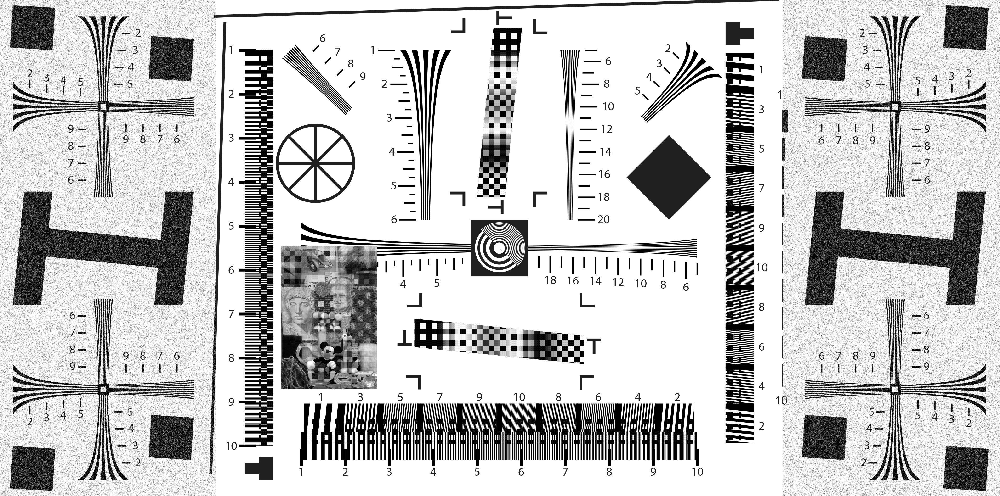

In [6]:
img_cfa = cv2.imread("CFA.bmp", cv2.IMREAD_GRAYSCALE)
Image.fromarray(img_cfa)

#### Полученное изображение

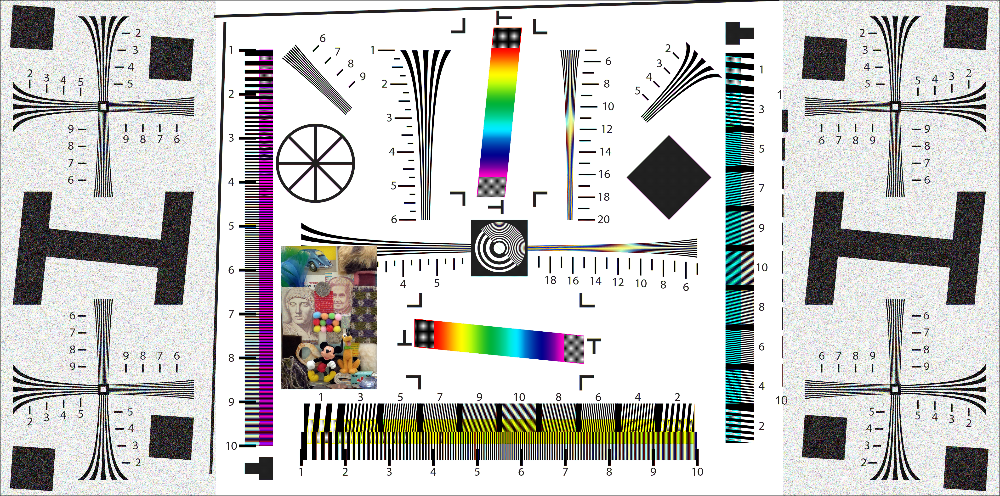

In [7]:
img_colored = cv2.imread("CFA_colored.bmp", cv2.IMREAD_COLOR)
# opencv читает изображения как BGR
img_colored = cv2.cvtColor(img_colored, cv2.COLOR_BGR2RGB)
Image.fromarray(img_colored)

#### Оригинальное изображение

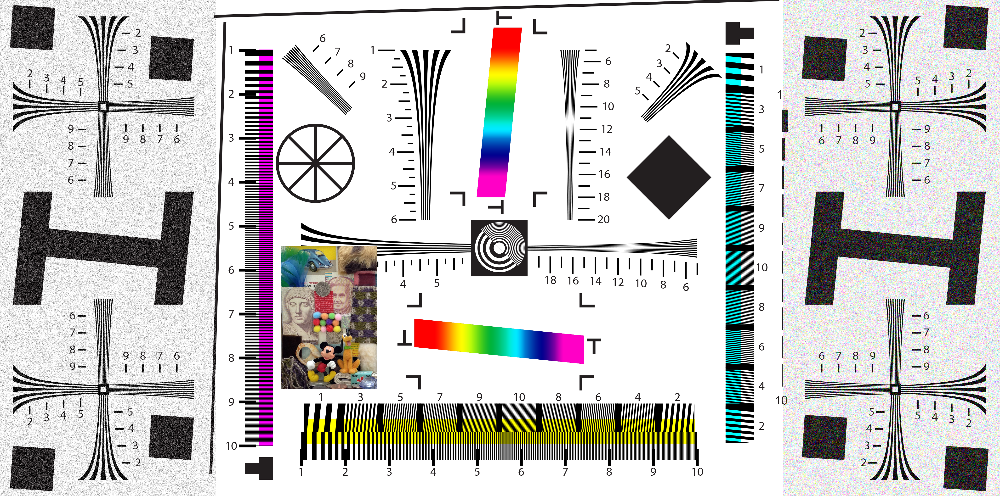

In [8]:
img_original = cv2.imread("Original.bmp", cv2.IMREAD_COLOR)
img_original = cv2.cvtColor(img_original, cv2.COLOR_BGR2RGB)
Image.fromarray(img_original)

Все линии остались различимыми. Некорректно отображаются цвета, у которых значения каналов сильно различаются (так как значения выходят из диапозона [0;255]).

#### Время работы и PSNR

In [9]:
print('Время работы алгоритма: %.2f сек/мп (%.2f c)' % (speed, working_time))

Время работы алгоритма: 27.68 сек/мп (239.62 c)


In [11]:
def func_rgb(pixel):
    R, G, B = pixel
    return 0.299 * R + 0.587 * G + 0.114 * B


MSE = ((np.apply_along_axis(func_rgb, -1, img_original) - 
       np.apply_along_axis(func_rgb, -1, img_colored)) ** 2).mean()
PSNR = 10 * np.log10(255 ** 2 / MSE)

In [12]:
print("PSNR: %.2f" % PSNR)

PSNR: 21.97
